In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import os
import umap
from sklearn.neighbors import NearestNeighbors
import leidenalg as la
import igraph as ig

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Function to perform UMAP, KNN, and Leiden clustering
def perform_umap_knn_leiden(df, title):
    cleaned_df = df.dropna()
    numeric_df = cleaned_df.iloc[:, 3:]  # Select only numeric columns for UMAP (skip the first two non-numeric columns)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    # Create a graph from the UMAP embedding
    knn_graph = NearestNeighbors(n_neighbors=15).fit(embedding)
    knn_graph_matrix = knn_graph.kneighbors_graph(embedding).toarray()
    
    # Convert the graph to an igraph object
    sources, targets = knn_graph_matrix.nonzero()
    edgelist = list(zip(sources.tolist(), targets.tolist()))
    graph = ig.Graph(edgelist)
    
    # Perform Leiden clustering on the graph
    partition = la.find_partition(graph, la.RBConfigurationVertexPartition)
    clusters = np.array(partition.membership)
    
    # Plot UMAP clustering
    plt.figure(figsize=(10, 6))
    plt.scatter(embedding[:, 0], embedding[:, 1], c=clusters, cmap='inferno', alpha=0.7)
    plt.colorbar(label='Cluster')
    plt.title(f'UMAP Clustering - {title}')
    plt.xlabel('UMAP 1')
    plt.ylabel('UMAP 2')
    plt.show()
    
    return numeric_df, clusters, embedding

# Perform UMAP, KNN, and Leiden clustering for each dataset
for i, df in enumerate(dfs):
    perform_umap_knn_leiden(df, f"Kinetics Donor {i+1}")



ValueError: Found array with 0 sample(s) (shape=(0, 25)) while a minimum of 1 is required by StandardScaler.

c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


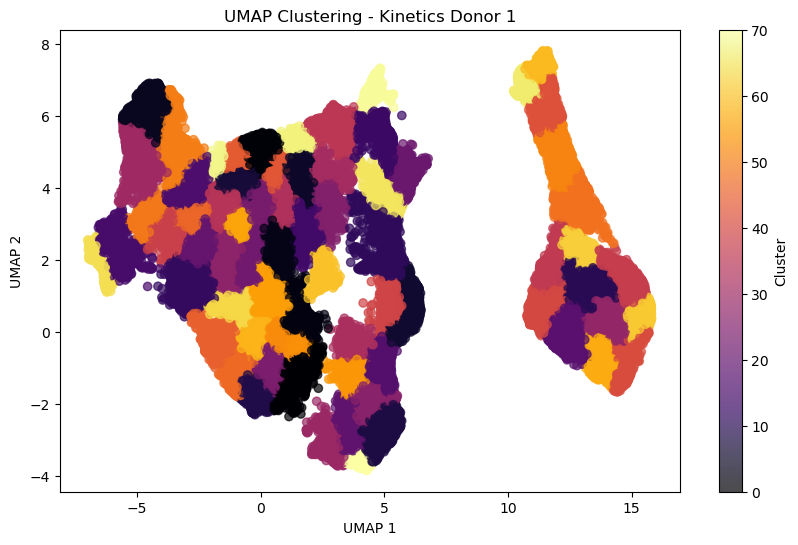

c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


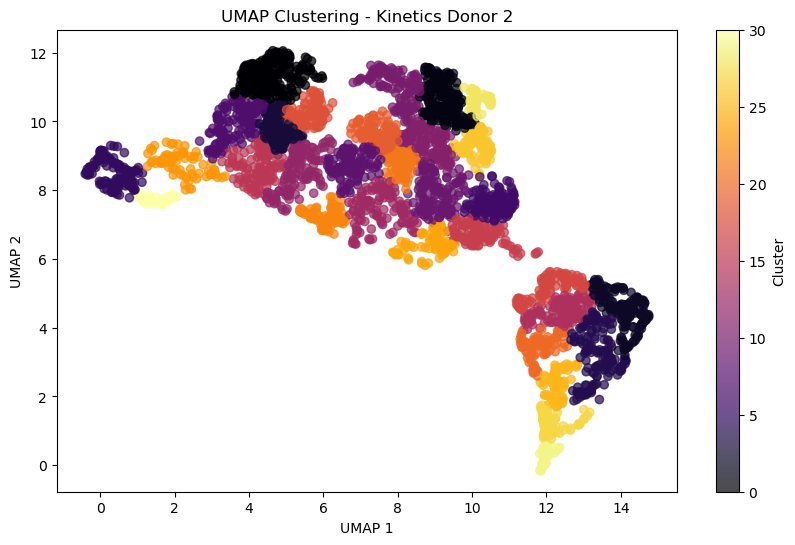

c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


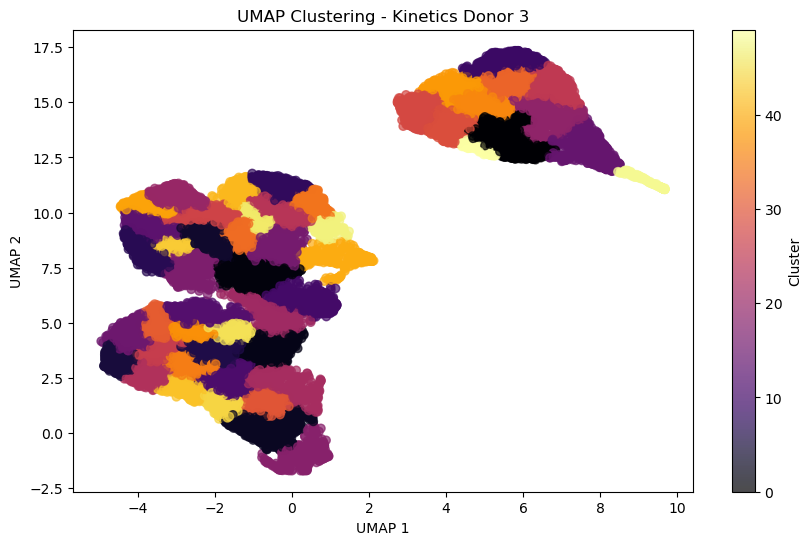

c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


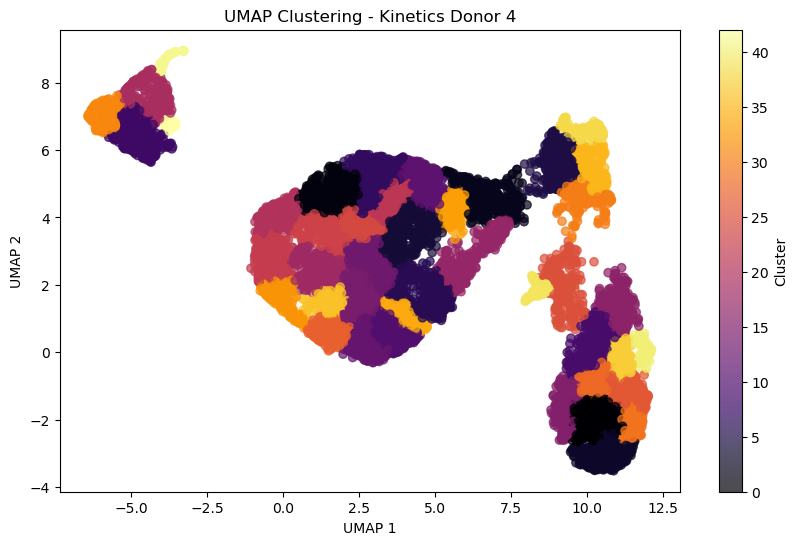

In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import os
import umap
from sklearn.neighbors import NearestNeighbors
import leidenalg as la
import igraph as ig

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Function to perform UMAP, KNN, and Leiden clustering
def perform_umap_knn_leiden(df, title):
    # Fill missing values with the mean of each column
    filled_df = df.fillna(df.mean())
    numeric_df = filled_df.iloc[:, 3:]  # Select only numeric columns for UMAP (skip the first three non-numeric columns)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    # Create a graph from the UMAP embedding
    knn_graph = NearestNeighbors(n_neighbors=15).fit(embedding)
    knn_graph_matrix = knn_graph.kneighbors_graph(embedding).toarray()
    
    # Convert the graph to an igraph object
    sources, targets = knn_graph_matrix.nonzero()
    edgelist = list(zip(sources.tolist(), targets.tolist()))
    graph = ig.Graph(edgelist)
    
    # Perform Leiden clustering on the graph
    partition = la.find_partition(graph, la.RBConfigurationVertexPartition)
    clusters = np.array(partition.membership)
    
    # Plot UMAP clustering
    plt.figure(figsize=(10, 6))
    plt.scatter(embedding[:, 0], embedding[:, 1], c=clusters, cmap='inferno', alpha=0.7)
    plt.colorbar(label='Cluster')
    plt.title(f'UMAP Clustering - {title}')
    plt.xlabel('UMAP 1')
    plt.ylabel('UMAP 2')
    plt.show()
    
    return numeric_df, clusters, embedding

# Perform UMAP, KNN, and Leiden clustering for each dataset
for i, df in enumerate(dfs):
    perform_umap_knn_leiden(df, f"Kinetics Donor {i+1}")


In [7]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import os
import umap
from sklearn.neighbors import NearestNeighbors
import leidenalg as la
import igraph as ig
import plotly.express as px

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Function to perform UMAP, KNN, and Leiden clustering on the pooled dataset
def perform_umap_knn_leiden_pooled(df, title):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    # Create a graph from the UMAP embedding using sparse matrix
    knn_graph = NearestNeighbors(n_neighbors=15).fit(embedding)
    knn_graph_matrix = knn_graph.kneighbors_graph(embedding)
    
    # Convert the graph to an igraph object
    sources, targets = knn_graph_matrix.nonzero()
    edgelist = list(zip(sources.tolist(), targets.tolist()))
    graph = ig.Graph(edgelist)
    
    # Perform Leiden clustering on the graph
    partition = la.find_partition(graph, la.RBConfigurationVertexPartition)
    clusters = np.array(partition.membership)
    
    # Create a DataFrame for the embedding and add cluster and dataset information
    embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])
    embedding_df['Cluster'] = clusters
    embedding_df['Dataset'] = df['Dataset'].values
    
    # Plot interactive UMAP with color coding by dataset of origin using Plotly
    fig_dataset = px.scatter(embedding_df, x='UMAP 1', y='UMAP 2', color='Dataset', title=f'UMAP Clustering by Dataset - {title}')
    fig_dataset.show()
    
    # Plot interactive UMAP with color coding by Leiden clustering using Plotly
    fig_cluster = px.scatter(embedding_df, x='UMAP 1', y='UMAP 2', color='Cluster', title=f'UMAP Clustering by Leiden - {title}')
    fig_cluster.show()
    
    return numeric_df, clusters, embedding

# Perform UMAP, KNN, and Leiden clustering on the pooled dataset and create interactive plots
perform_umap_knn_leiden_pooled(pooled_df, "Pooled Datasets")



c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


(       NUMBER_SPOTS  NUMBER_GAPS  NUMBER_SPLITS  NUMBER_MERGES  \
 0               129            3              0              0   
 1               150            4              0              0   
 2                 6            1              0              0   
 3                74            1              0              0   
 4                29            0              0              0   
 ...             ...          ...            ...            ...   
 11643             2            0              0              0   
 11644             2            0              0              0   
 11645             2            0              0              0   
 11646             2            0              0              0   
 11647             2            0              0              0   
 
        NUMBER_COMPLEX  LONGEST_GAP  TRACK_DURATION  TRACK_START  TRACK_STOP  \
 0                   0            4             134            0         134   
 1                   0            

c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



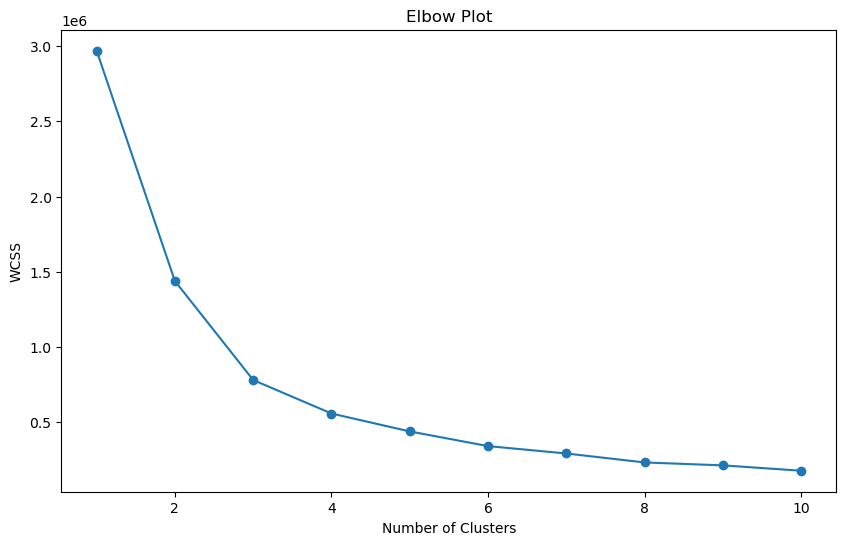

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import os
import umap
import plotly.express as px

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Function to perform UMAP and generate an elbow plot to determine the optimal number of clusters
def perform_umap_and_elbow_plot(df, title):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    # Determine the optimal number of clusters using the elbow method
    wcss = []
    for n in range(1, 11):
        kmeans = KMeans(n_clusters=n, random_state=42)
        kmeans.fit(embedding)
        wcss.append(kmeans.inertia_)
    
    # Plot the elbow plot
    plt.figure(figsize=(10, 6))
    plt.plot(range(1, 11), wcss, marker='o')
    plt.title('Elbow Plot')
    plt.xlabel('Number of Clusters')
    plt.ylabel('WCSS')
    plt.show()
    
    return embedding

# Perform UMAP and generate an elbow plot on the pooled dataset
embedding = perform_umap_and_elbow_plot(pooled_df, "Pooled Datasets")

# Based on the elbow plot, manually assign clusters (e.g., using 4 clusters)
optimal_clusters = 10

# Perform KMeans clustering with the optimal number of clusters
kmeans = KMeans(n_clusters=optimal_clusters, random_state=42)
clusters = kmeans.fit_predict(embedding)

# Create a DataFrame for the embedding and add cluster and dataset information
embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])
embedding_df['Cluster'] = clusters
embedding_df['Dataset'] = pooled_df['Dataset'].values

# Plot interactive UMAP with color coding by KMeans clustering using Plotly
fig_cluster = px.scatter(embedding_df, x='UMAP 1', y='UMAP 2', color='Cluster', title='UMAP Clustering by KMeans - Pooled Datasets')
fig_cluster.show()



c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



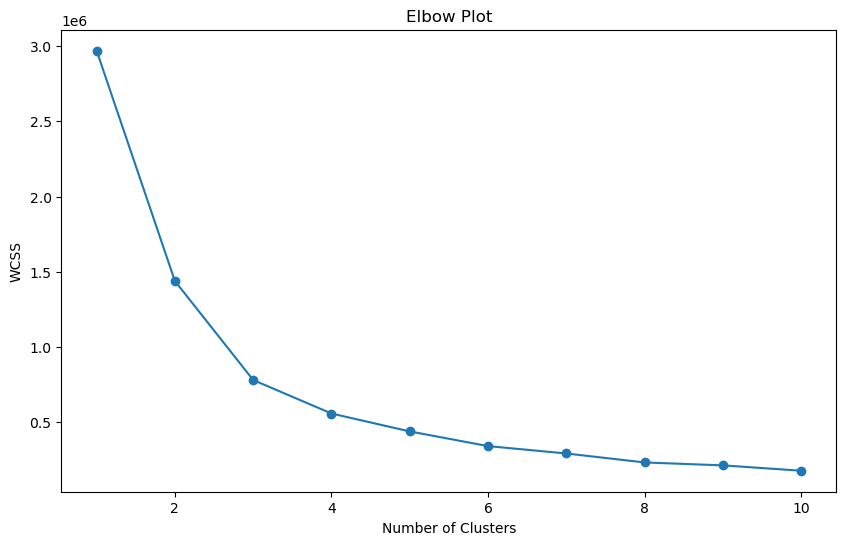

In [12]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import os
import umap
import plotly.express as px

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Function to perform UMAP and generate an elbow plot to determine the optimal number of clusters
def perform_umap_and_elbow_plot(df, title):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    # Determine the optimal number of clusters using the elbow method
    wcss = []
    for n in range(1, 11):
        kmeans = KMeans(n_clusters=n, random_state=42)
        kmeans.fit(embedding)
        wcss.append(kmeans.inertia_)
    
    # Plot the elbow plot
    plt.figure(figsize=(10, 6))
    plt.plot(range(1, 11), wcss, marker='o')
    plt.title('Elbow Plot')
    plt.xlabel('Number of Clusters')
    plt.ylabel('WCSS')
    plt.show()
    
    return embedding

# Perform UMAP and generate an elbow plot on the pooled dataset
embedding = perform_umap_and_elbow_plot(pooled_df, "Pooled Datasets")

# Based on the elbow plot, manually assign clusters (e.g., using 4 clusters)
optimal_clusters = 10

# Perform KMeans clustering with the optimal number of clusters
kmeans = KMeans(n_clusters=optimal_clusters, random_state=42)
clusters = kmeans.fit_predict(embedding)

# Create a DataFrame for the embedding and add cluster and dataset information
embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])
embedding_df['Cluster'] = clusters
embedding_df['Dataset'] = pooled_df['Dataset'].values

# Plot interactive UMAP with color coding by KMeans clustering using Plotly
fig_cluster = px.scatter(embedding_df, x='UMAP 1', y='UMAP 2', color='Cluster', title='UMAP Clustering by KMeans - Pooled Datasets')
fig_cluster.show()


c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



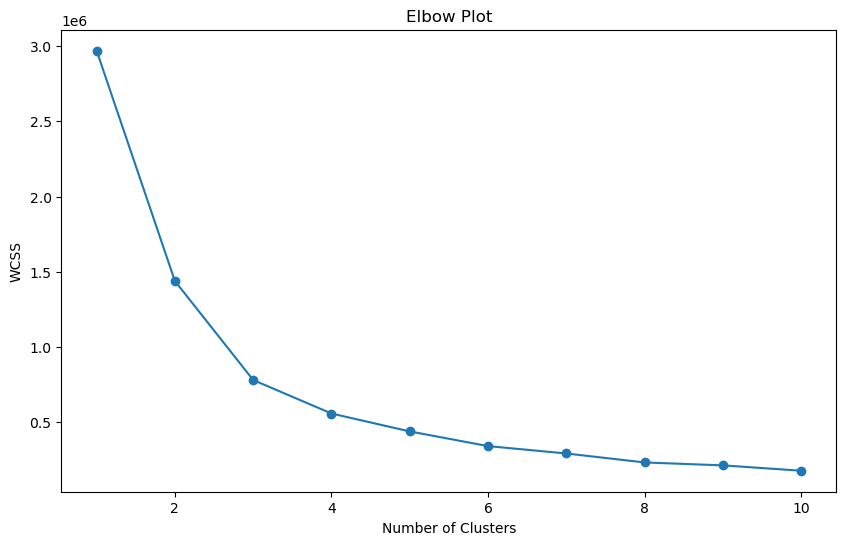

In [13]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import os
import umap
import plotly.express as px

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Function to perform UMAP and generate an elbow plot to determine the optimal number of clusters
def perform_umap_and_elbow_plot(df, title):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    # Determine the optimal number of clusters using the elbow method
    wcss = []
    for n in range(1, 11):
        kmeans = KMeans(n_clusters=n, random_state=42)
        kmeans.fit(embedding)
        wcss.append(kmeans.inertia_)
    
    # Plot the elbow plot
    plt.figure(figsize=(10, 6))
    plt.plot(range(1, 11), wcss, marker='o')
    plt.title('Elbow Plot')
    plt.xlabel('Number of Clusters')
    plt.ylabel('WCSS')
    plt.show()
    
    return embedding

# Perform UMAP and generate an elbow plot on the pooled dataset
embedding = perform_umap_and_elbow_plot(pooled_df, "Pooled Datasets")

# Based on the elbow plot, manually assign clusters (e.g., using 4 clusters)
optimal_clusters = 9

# Perform KMeans clustering with the optimal number of clusters
kmeans = KMeans(n_clusters=optimal_clusters, random_state=42)
clusters = kmeans.fit_predict(embedding)

# Create a DataFrame for the embedding and add cluster and dataset information
embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])
embedding_df['Cluster'] = clusters
embedding_df['Dataset'] = pooled_df['Dataset'].values

# Plot interactive UMAP with color coding by KMeans clustering using Plotly
fig_cluster = px.scatter(embedding_df, x='UMAP 1', y='UMAP 2', color='Cluster', title='UMAP Clustering by KMeans - Pooled Datasets')
fig_cluster.show()


c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



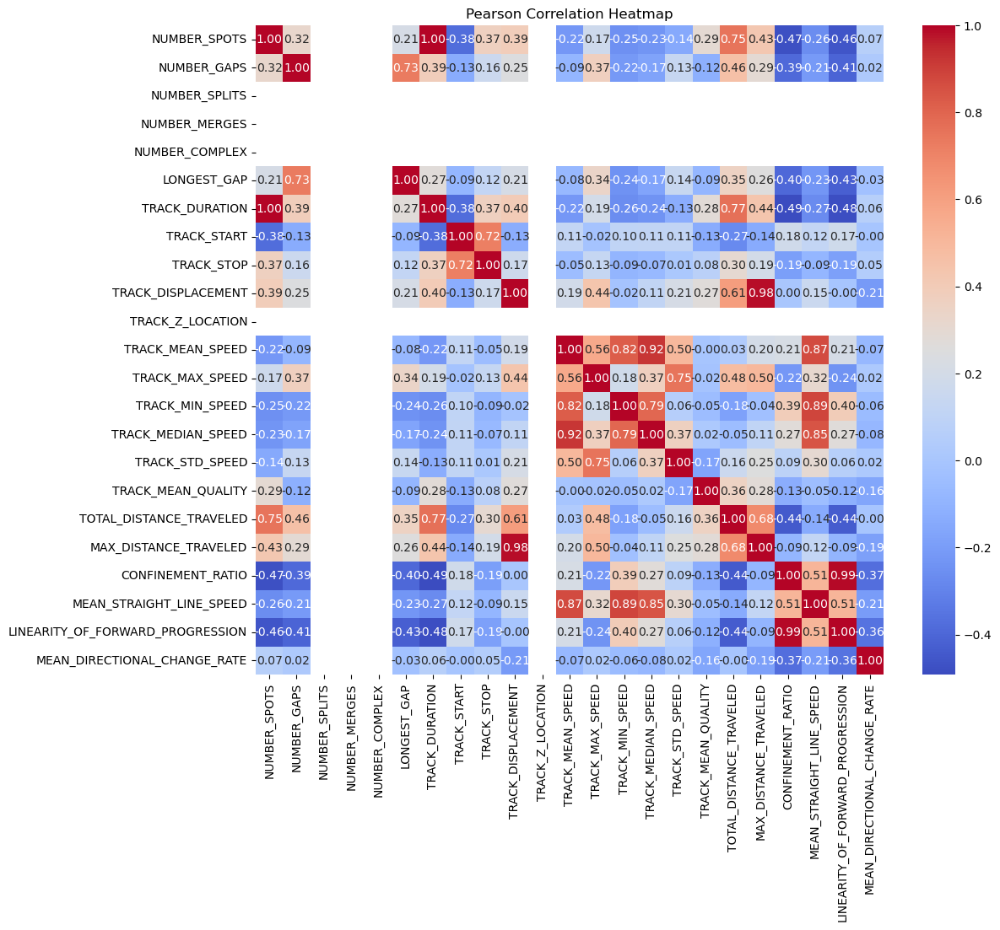

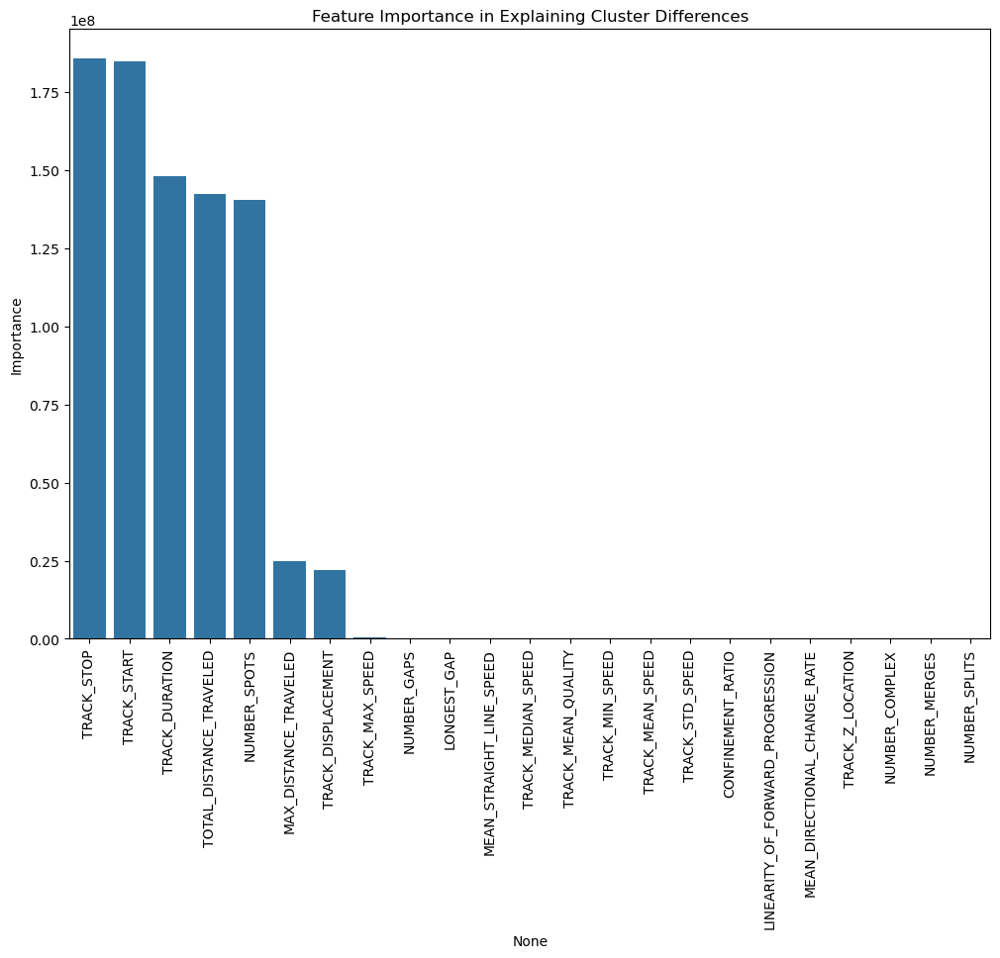

In [16]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.inspection import permutation_importance
import os

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Remove the columns TRACK_X_LOCATION and TRACK_Y_LOCATION from the analysis
pooled_df = pooled_df.drop(columns=['TRACK_X_LOCATION', 'TRACK_Y_LOCATION'])

# Function to perform UMAP and KMeans clustering on the pooled dataset
def perform_umap_and_kmeans(df, n_clusters):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    # Perform KMeans clustering with the specified number of clusters
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    clusters = kmeans.fit_predict(embedding)
    
    return embedding, clusters

# Perform UMAP and KMeans clustering on the pooled dataset with 9 clusters
embedding, clusters = perform_umap_and_kmeans(pooled_df, n_clusters=9)

# Create a DataFrame for the embedding and add cluster and dataset information
embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])
embedding_df['Cluster'] = clusters
embedding_df['Dataset'] = pooled_df['Dataset'].values

# Run Pearson correlation to determine parameter correlation and display as a heatmap
correlation_matrix = pooled_df.iloc[:, 3:-1].corr(method='pearson')

plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Pearson Correlation Heatmap')
plt.show()

# Generate a plot that displays the relative importance of each parameter in explaining differences between clusters
X = pooled_df.iloc[:, 3:-1]
y = clusters

model = KMeans(n_clusters=9, random_state=42).fit(X)
result = permutation_importance(model, X, y, n_repeats=10, random_state=42)

importance_df = pd.DataFrame(result.importances_mean, index=X.columns, columns=['Importance']).sort_values(by='Importance', ascending=False)

plt.figure(figsize=(12, 8))
sns.barplot(x=importance_df.index, y='Importance', data=importance_df)
plt.xticks(rotation=90)
plt.title('Feature Importance in Explaining Cluster Differences')
plt.show()

